In [8]:
from pathlib import Path
import numpy as np
import json
from PIL import Image,ImageDraw
from concurrent.futures import ProcessPoolExecutor
from tqdm import tqdm
import csv
import pandas as pd
import matplotlib.pyplot as plt


import warnings
warnings.filterwarnings("ignore")

# bboxのついたデータを取得

In [2]:
# csvの読み込み
def read_csv(path):
    with open(path, "r") as f:
        data = f.readlines()
    return data

boxable_name = read_csv("/home/dataset/openimage/oidv7-class-descriptions-boxable.csv")
train_boxable_name = read_csv("/home/dataset/openimage/train-annotations-human-imagelabels-boxable.csv")
# 基本的にこれに従えばいいと思われる
train_annotations_bbox = read_csv("/home/dataset/openimage/bbox/train-annotations-bbox.csv")

# 各々の要素が文字列になっており，配列で番号指定できないので修正
# train_boxable_name = [row.strip().split(',') for row in train_boxable_name]
train_annotations_bbox = [row.strip().split(',') for row in train_annotations_bbox]
# train_boxable_name = np.array(train_boxable_name)
train_annotations_bbox = np.array(train_annotations_bbox)

"""手動で自然物を抜いたデータセット"""
artificial_data = read_csv("/home/oshita/vlm/mirage-defect/oshita_check_extract_openimage_class.csv")   
artificial_data = [row.strip().split(',') for row in artificial_data]
artificial_data = np.array(artificial_data)

In [8]:
# # データの読み込み
# train_annotations_np = np.array(train_annotations_bbox)
# artificial_data_set = set(artificial_data[:, 0])

# def process_batch(batch):
#     # バッチ内の各データに対して処理を適用
#     return [data for data in batch if data[3] == '1' and data[2] in artificial_data_set]

# # データをバッチに分割
# batch_size = 30000  # バッチサイズは環境に応じて調整
# batches = [train_annotations_np[i:i + batch_size] for i in range(0, len(train_annotations_np), batch_size)]

# # プロセスベースの並列処理
# worker_count = 16  # CPUコア数に基づく
# with ProcessPoolExecutor(max_workers=worker_count) as executor:
#     # 進捗バーと共に各バッチを並列処理
#     results = list(tqdm(executor.map(process_batch, batches), total=len(batches)))

# # 結果の結合
# caribration_data = [item for sublist in results for item in sublist]

# # CSVファイルに保存
# with open('filtered_data.csv', 'w', newline='', encoding='utf-8') as file:
#     writer = csv.writer(file)
#     writer.writerow(['ImageID', 'Source', 'LabelName', 'Confidence', 'XMin', 'XMax', 'YMin', 'YMax', 
#                      'IsOccluded', 'IsTruncated', 'IsGroupOf', 'IsDepiction', 'IsInside', 
#                      'XClick1X', 'XClick2X', 'XClick3X', 'XClick4X', 'XClick1Y', 'XClick2Y', 
#                      'XClick3Y', 'XClick4Y'])
#     writer.writerows(caribration_data)

100%|██████████| 488/488 [01:00<00:00,  8.11it/s]


# filteringしたデータの読み込み，bboxの可視化

In [13]:
filtered_train_annotations_bbox = pd.read_csv("/home/oshita/vlm/mirage-defect/filtered_data.csv")
boxable_name = np.array(boxable_name)
filtered_train_annotations_bbox = filtered_train_annotations_bbox[
    (filtered_train_annotations_bbox["IsOccluded"] == 0) &
    (filtered_train_annotations_bbox["IsTruncated"] == 0) &
    (filtered_train_annotations_bbox["IsInside"] == 0) &
    (filtered_train_annotations_bbox["IsDepiction"] == 0) &
    (filtered_train_annotations_bbox["IsGroupOf"] == 0) &
    ((filtered_train_annotations_bbox["Source"] == "activemil") | (filtered_train_annotations_bbox["Source"] == "verification"))
]
filtered_train_annotations_bbox

"""
何も除去しない場合 len 8379006
1~5のすべての汚れを削除するとlenは 2209520

1.IsOccluded: オブジェクトが画像内の別のオブジェクトによって遮られていることを示します。
2.IsTruncated: オブジェクトが画像の境界を越えて広がっていることを示します。
3.IsGroupOf: ボックスがオブジェクトのグループ (花壇や群衆など) にまたがることを示します。私たちはアノテーターに対し、インスタンスが 5 つを超え、互いに大きく遮蔽され、物理的に接触しているケースにこのタグを使用するよう依頼しました。
4.IsDepiction: オブジェクトが描写であることを示します (たとえば、実際の物理的なインスタンスではなく、オブジェクトの漫画や図面など)。
5.IsInside: オブジェクトの内側から撮影された写真を示します (例: 車の室内や建物の内部)。

Sourceの種類について
* "freeform"そして"xclick"人間が描いた箱です。
* "activemil"ボックスは、アクティブ MIL プロセスを通じて人間が密閉している (IoU > 0.7) ことが検証されたボックスです。
* "verification" Google 内部の物体検出モデルから、人間が厳密である (IoU > 0.7) と検証したボックスです。

さらにSourceについてactivemil,verificationに絞ると 343454

"""




'\n何も除去しない場合 len 8379006\n1~5のすべての汚れを削除するとlenは 2209520\n\n1.IsOccluded: オブジェクトが画像内の別のオブジェクトによって遮られていることを示します。\n2.IsTruncated: オブジェクトが画像の境界を越えて広がっていることを示します。\n3.IsGroupOf: ボックスがオブジェクトのグループ (花壇や群衆など) にまたがることを示します。私たちはアノテーターに対し、インスタンスが 5 つを超え、互いに大きく遮蔽され、物理的に接触しているケースにこのタグを使用するよう依頼しました。\n4.IsDepiction: オブジェクトが描写であることを示します (たとえば、実際の物理的なインスタンスではなく、オブジェクトの漫画や図面など)。\n5.IsInside: オブジェクトの内側から撮影された写真を示します (例: 車の室内や建物の内部)。\n\nSourceの種類について\n* "freeform"そして"xclick"人間が描いた箱です。\n* "activemil"ボックスは、アクティブ MIL プロセスを通じて人間が密閉している (IoU > 0.7) ことが検証されたボックスです。\n* "verification" Google 内部の物体検出モデルから、人間が厳密である (IoU > 0.7) と検証したボックスです。\n\nさらにSourceについてactivemil,verificationに絞ると 343454\n\n'

0

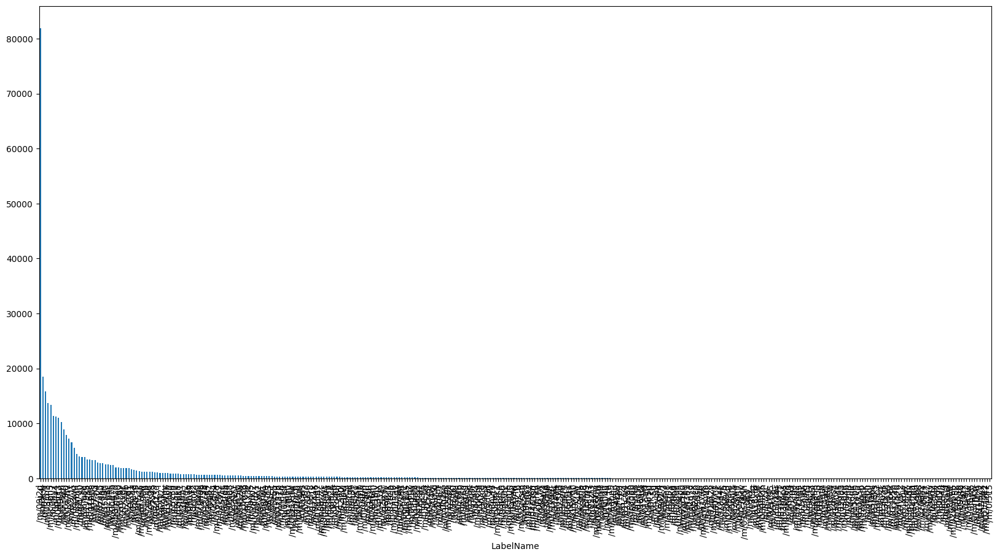

In [16]:
# filtered_train_annotations_bboxの"LabelName"のユニークを取得し，各々の数をカウント
filtered_train_annotations_bbox["LabelName"].value_counts()
# filtered_train_annotations_bbox["LabelName"].value_counts()をグラフ化
filtered_train_annotations_bbox["LabelName"].value_counts().plot.bar(figsize=(20, 10))
# 数が10以下のものをカウント
filtered_train_annotations_bbox["LabelName"].value_counts()[filtered_train_annotations_bbox["LabelName"].value_counts() == 0].count()

In [88]:
# ImageIDのユニークな値を取得
unique_image_id = filtered_train_annotations_bbox["ImageID"].unique()
#特定のImageIDのデータを抽出
target_image_id = unique_image_id[7]
filtered_data_by_imageid = filtered_train_annotations_bbox[filtered_train_annotations_bbox["ImageID"] == target_image_id]
filtered_data_by_imageid

,ImageID,Source,LabelName,Confidence,XMin,XMax,YMin,YMax,IsOccluded,IsTruncated,...,IsDepiction,IsInside,XClick1X,XClick2X,XClick3X,XClick4X,XClick1Y,XClick2Y,XClick3Y,XClick4Y
72,00002b368e91b947,xclick,/m/01cmb2,1,0.446,0.658,0.622611,0.921975,0,0,...,0,0,0.503,0.658,0.446,0.541,0.622611,0.805732,0.855096,0.921975
82,00002b368e91b947,xclick,/m/09j5n,1,0.437,0.455,0.605096,0.640127,0,0,...,0,0,0.455,0.437,0.442,0.450,0.605096,0.617834,0.635350,0.640127
85,00002b368e91b947,xclick,/m/09j5n,1,0.783,0.844,0.851911,0.906051,0,0,...,0,0,0.836,0.844,0.791,0.783,0.906051,0.891720,0.851911,0.880573
86,00002b368e91b947,xclick,/m/09j5n,1,0.912,0.938,0.689490,0.730892,0,0,...,0,0,0.922,0.912,0.922,0.938,0.689490,0.703822,0.730892,0.729299
87,00002b368e91b947,xclick,/m/09j5n,1,0.936,0.988,0.691083,0.732484,0,0,...,0,0,0.964,0.936,0.986,0.988,0.691083,0.697452,0.732484,0.726115


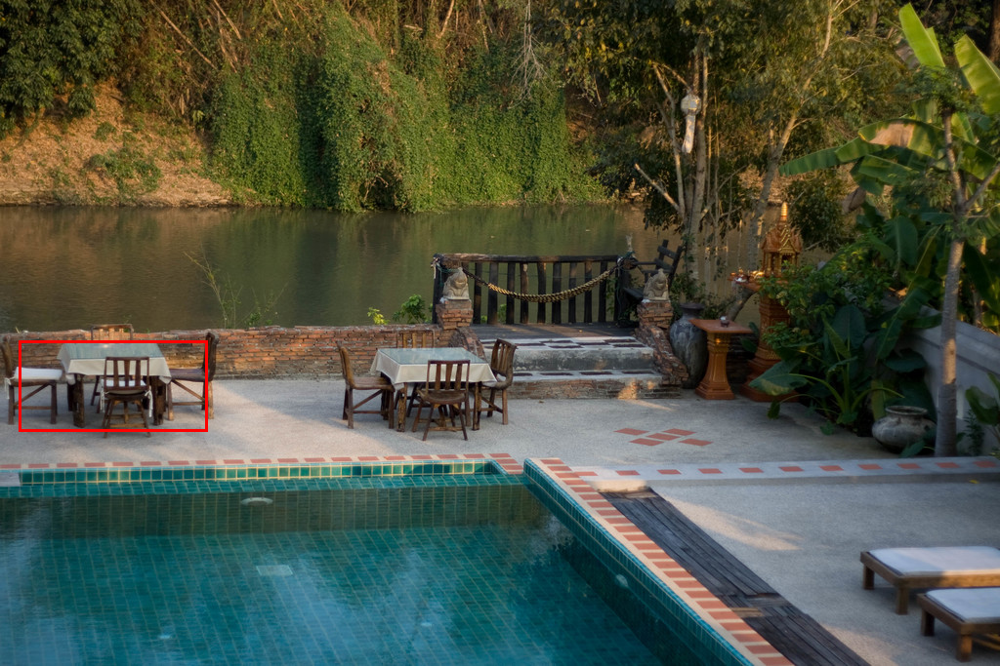

['Kitchen & dining room table\n']


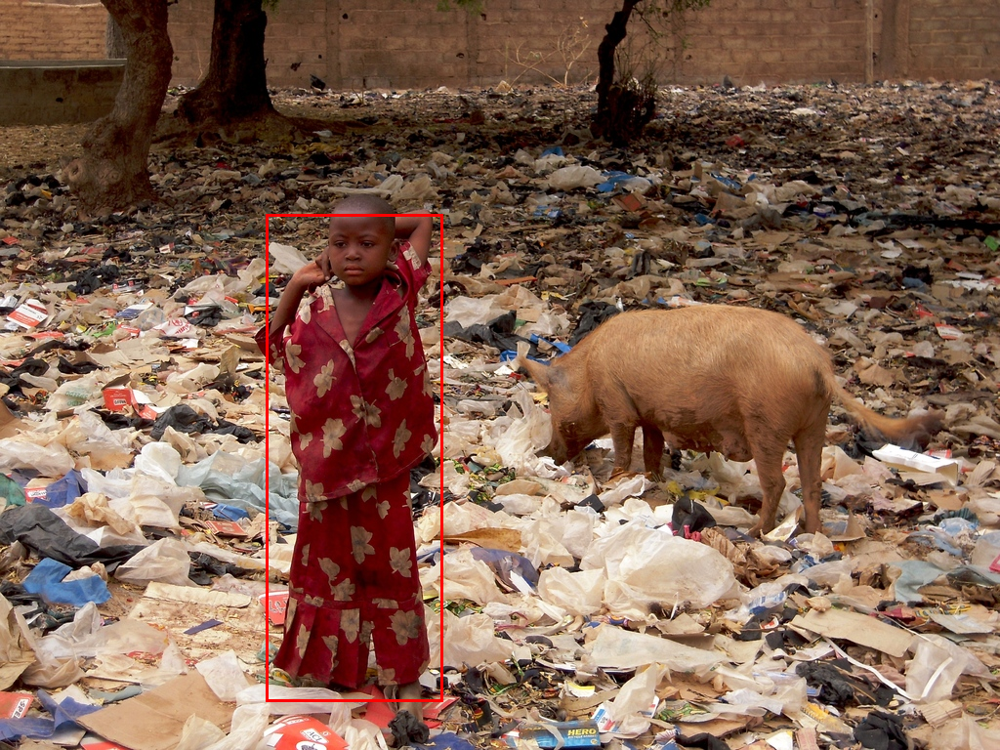

['Clothing\n']


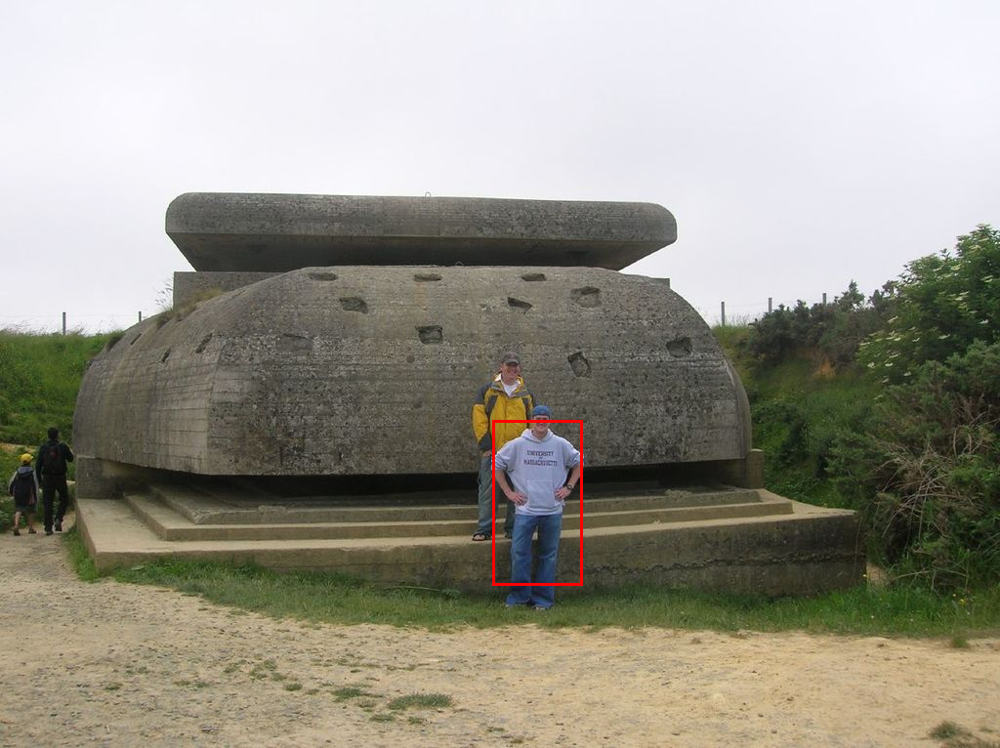

['Clothing\n']


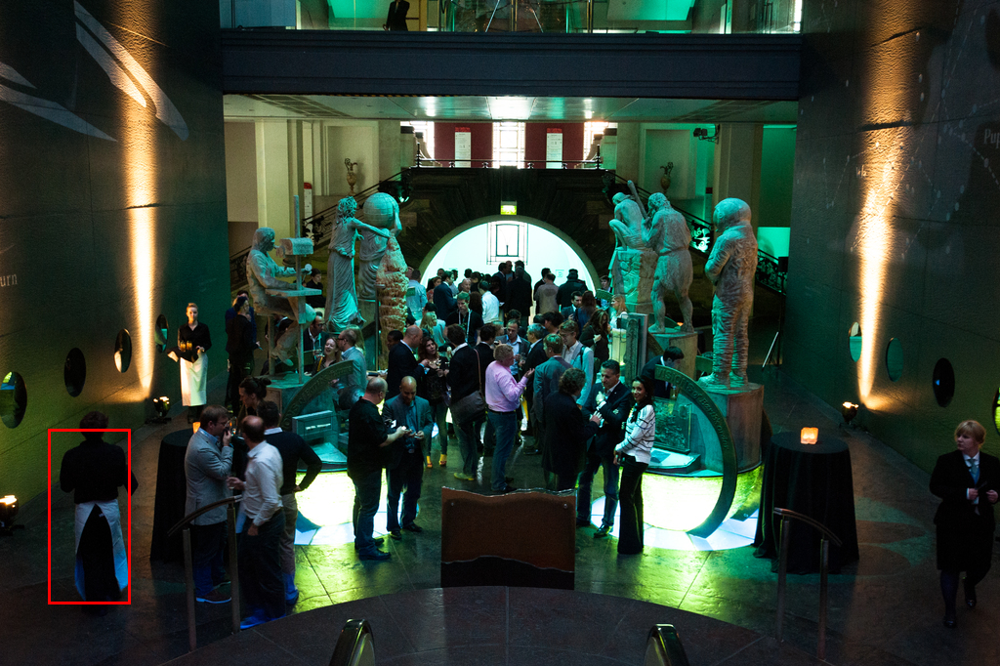

['Clothing\n']


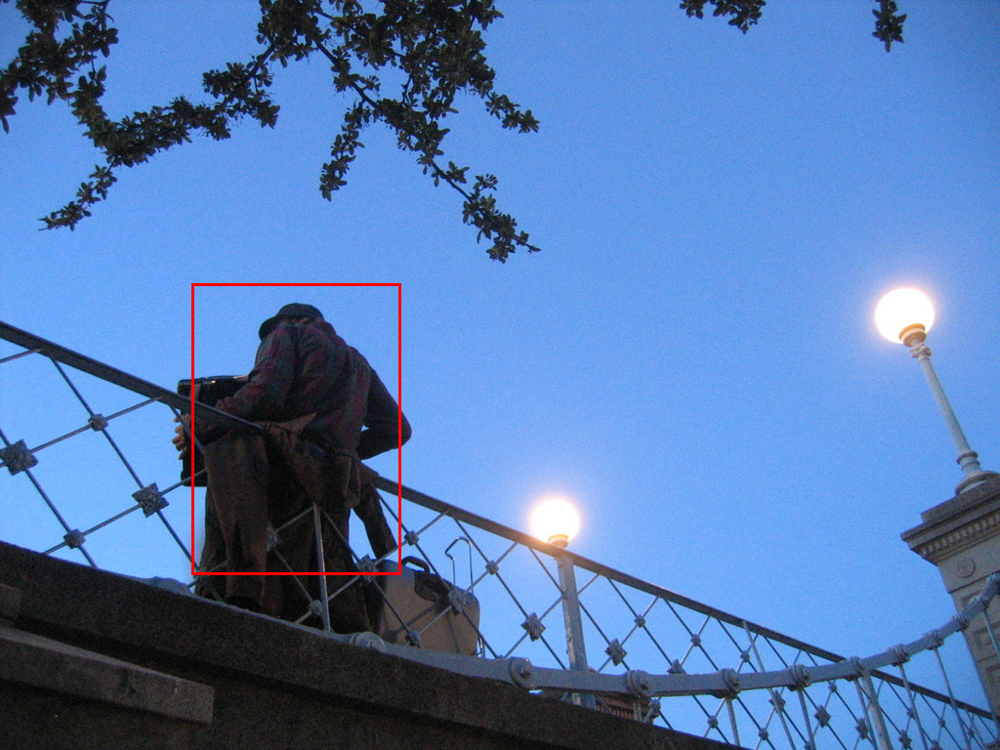

['Clothing\n']


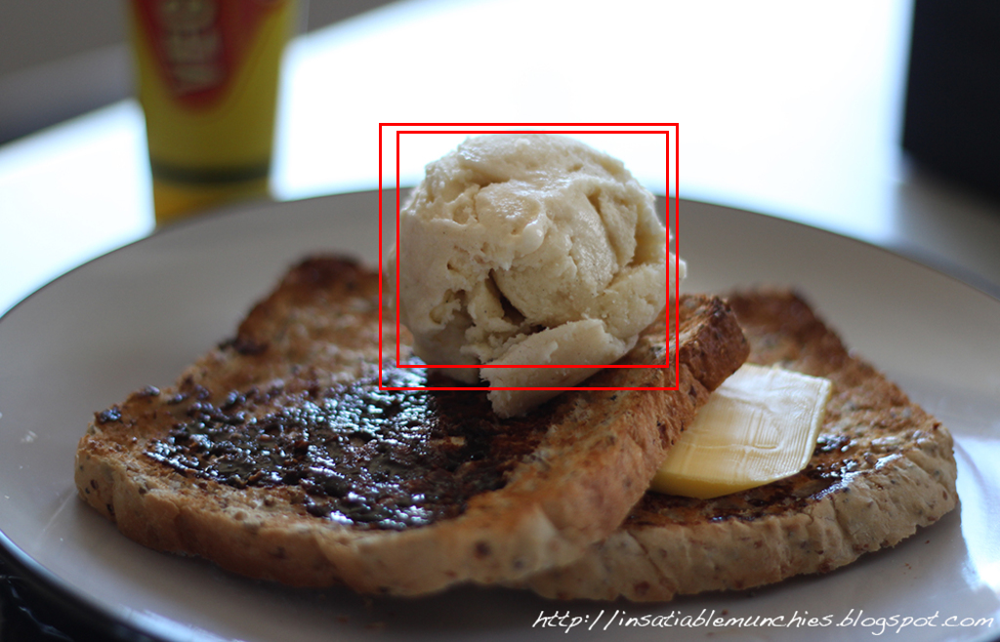

['Dairy Product\n' 'Ice cream\n']


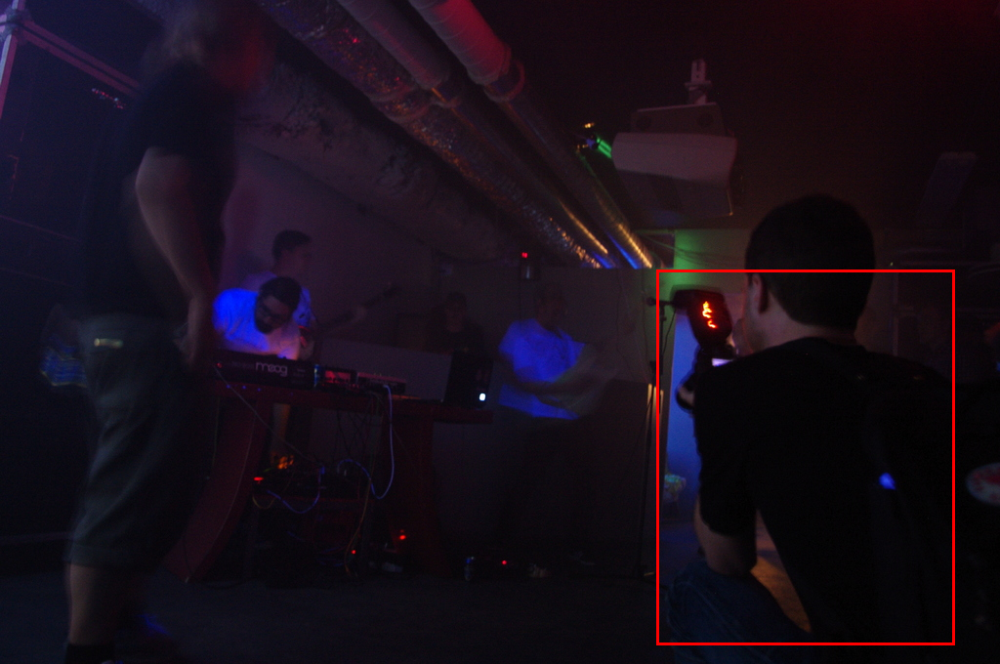

['Clothing\n']


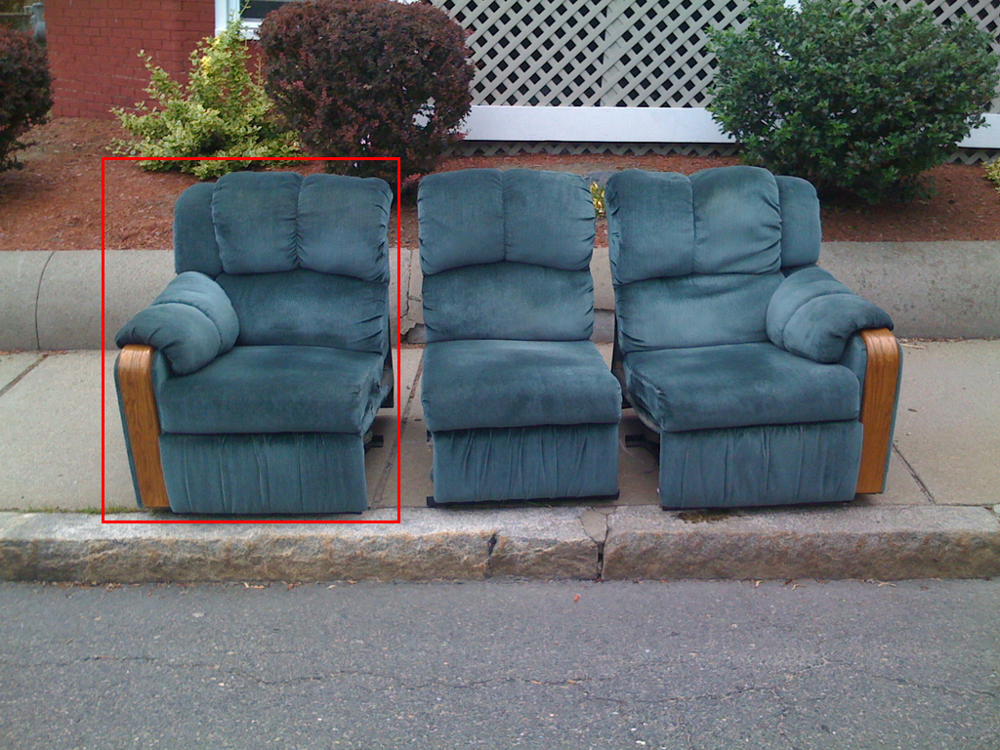

['Chair\n']


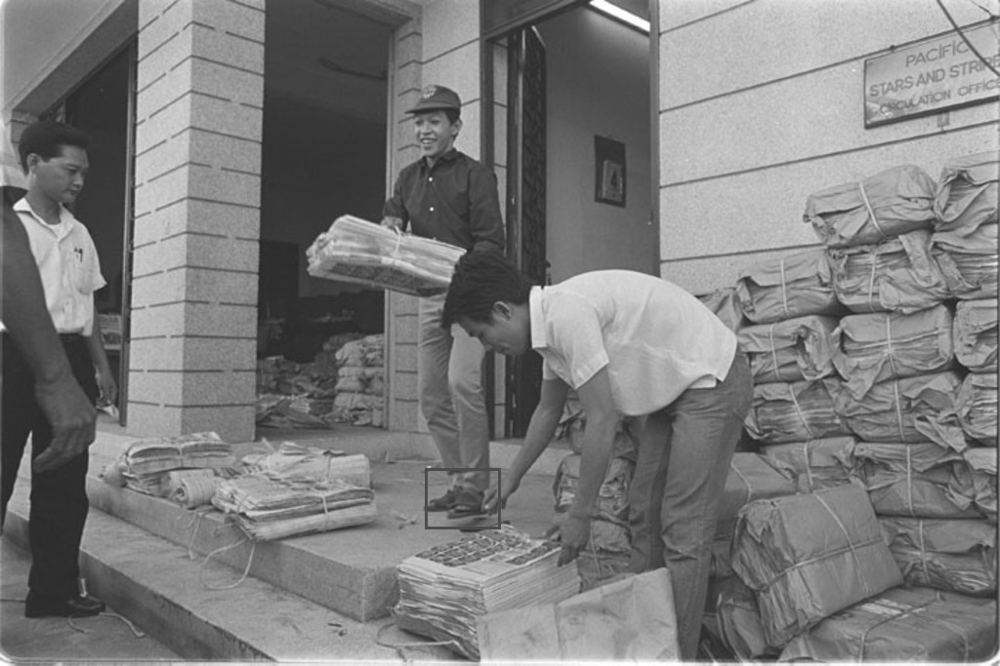

['Footwear\n']


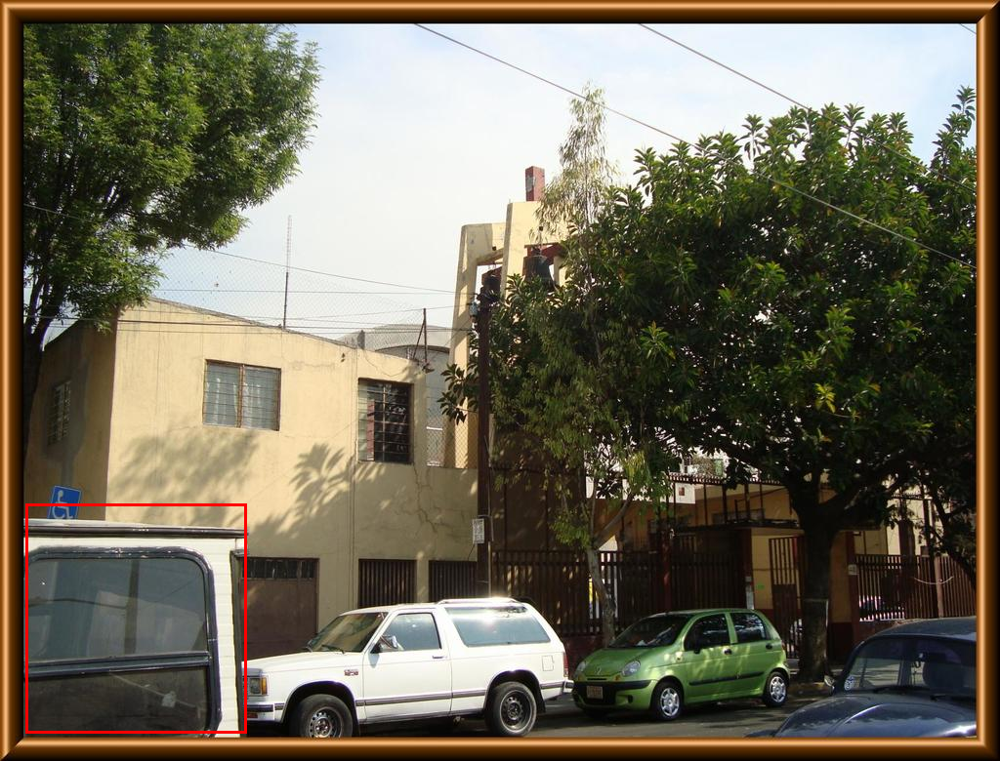

['Window\n']


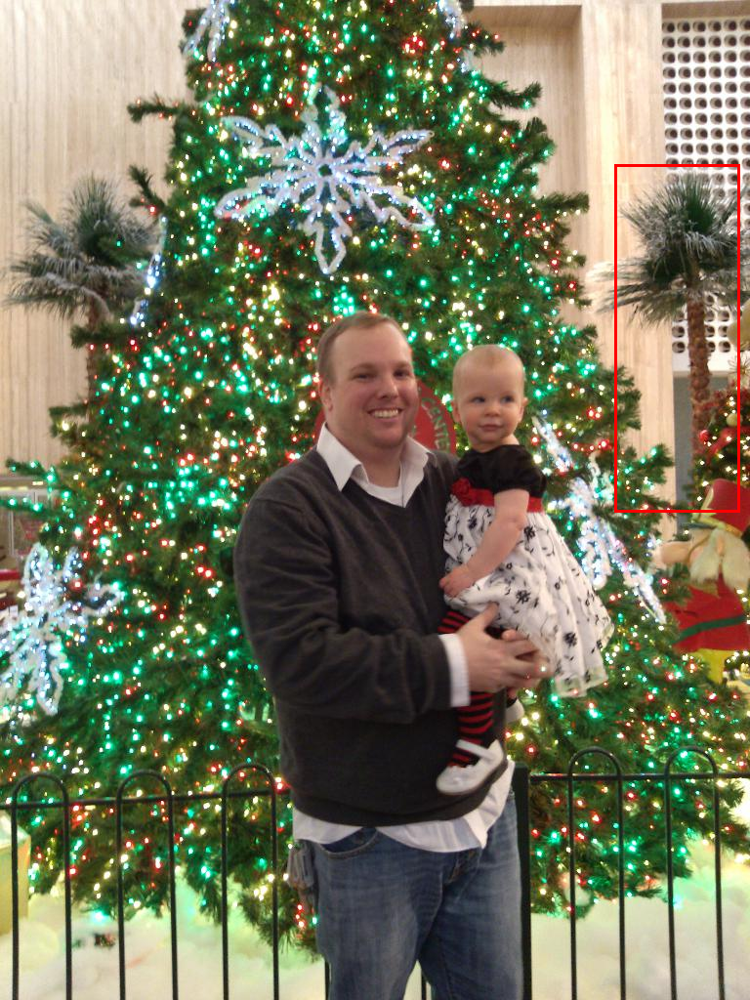

['Houseplant\n']


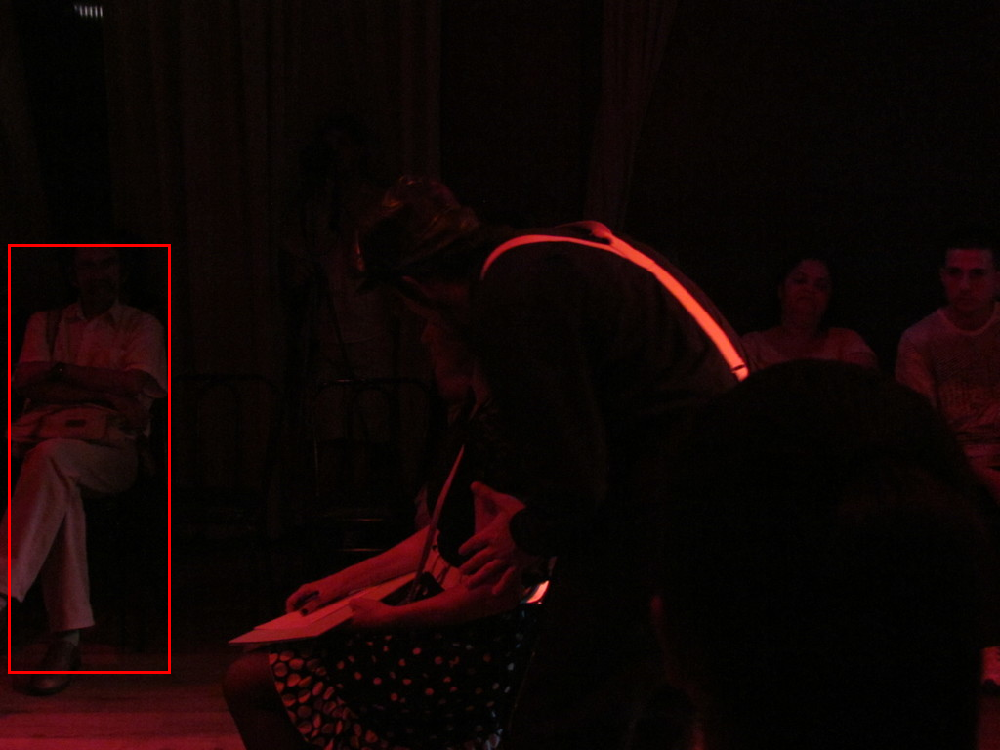

['Clothing\n']


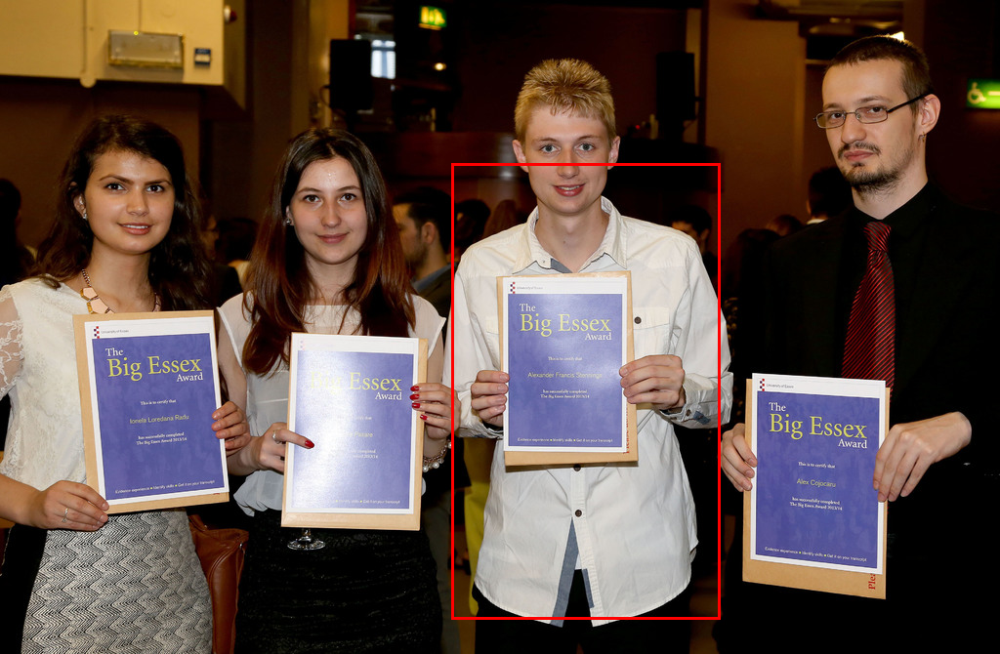

['Clothing\n']


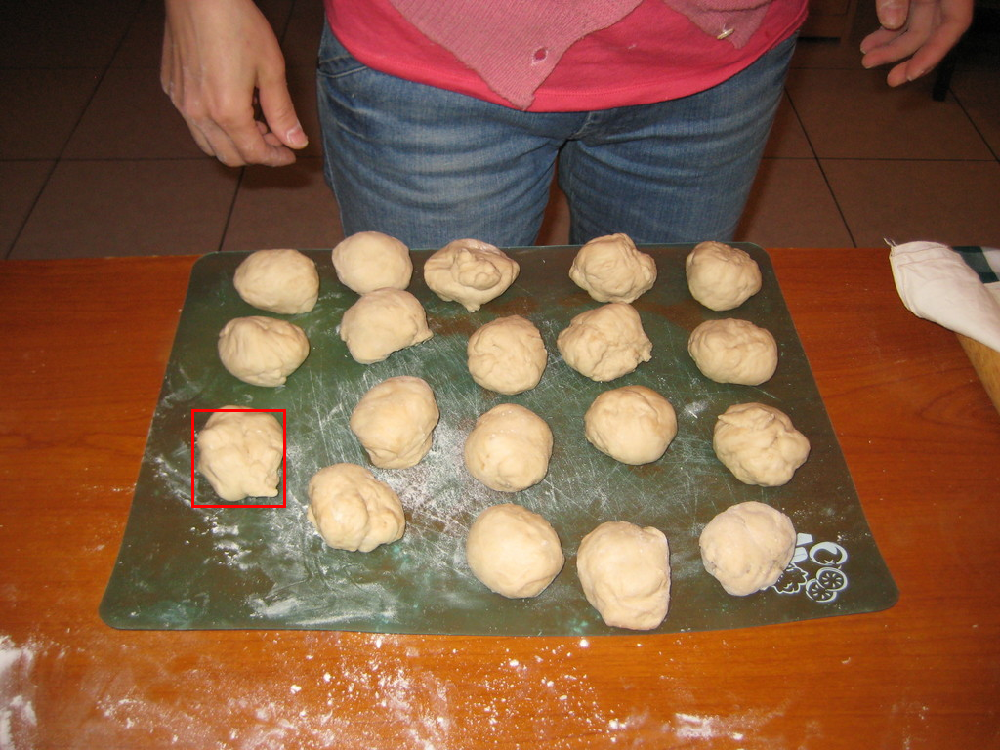

['Food\n']


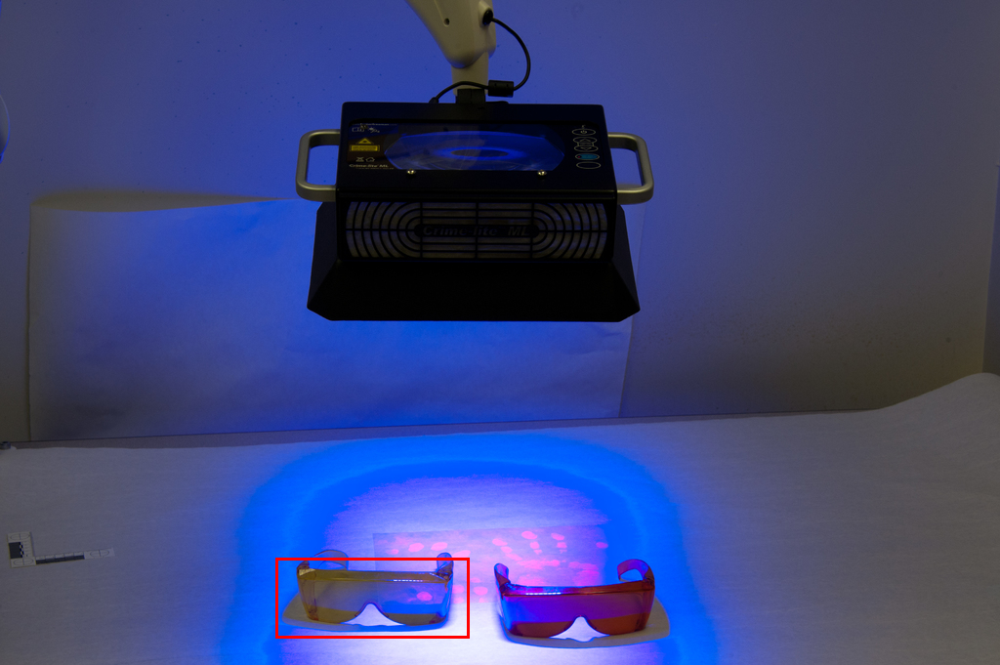

['Glasses\n']


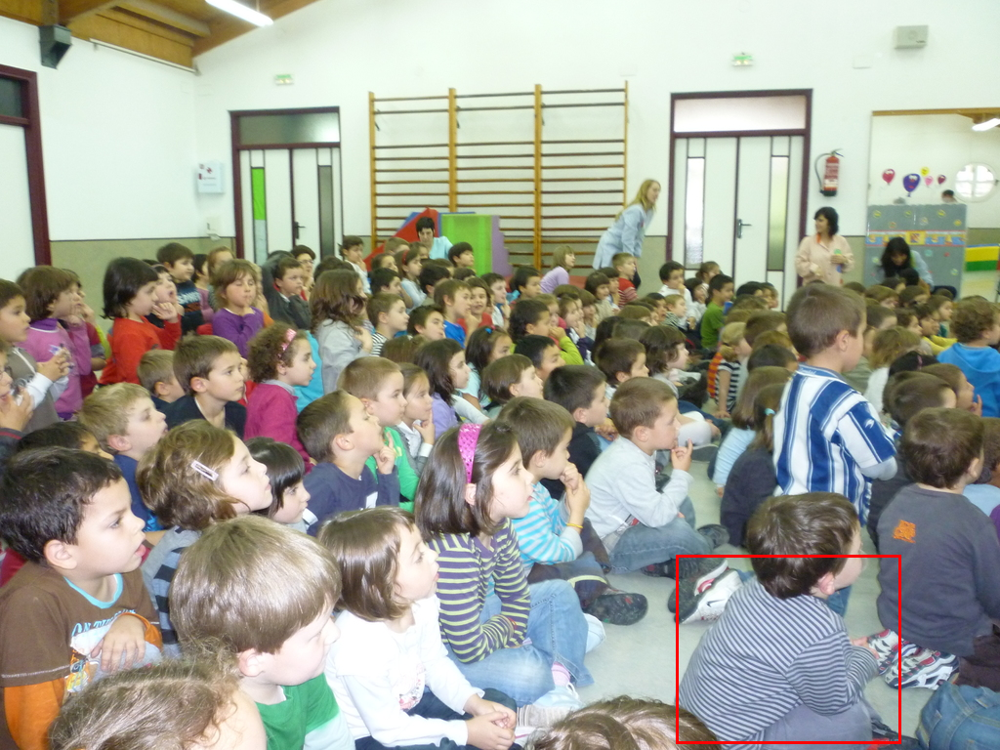

['Clothing\n']


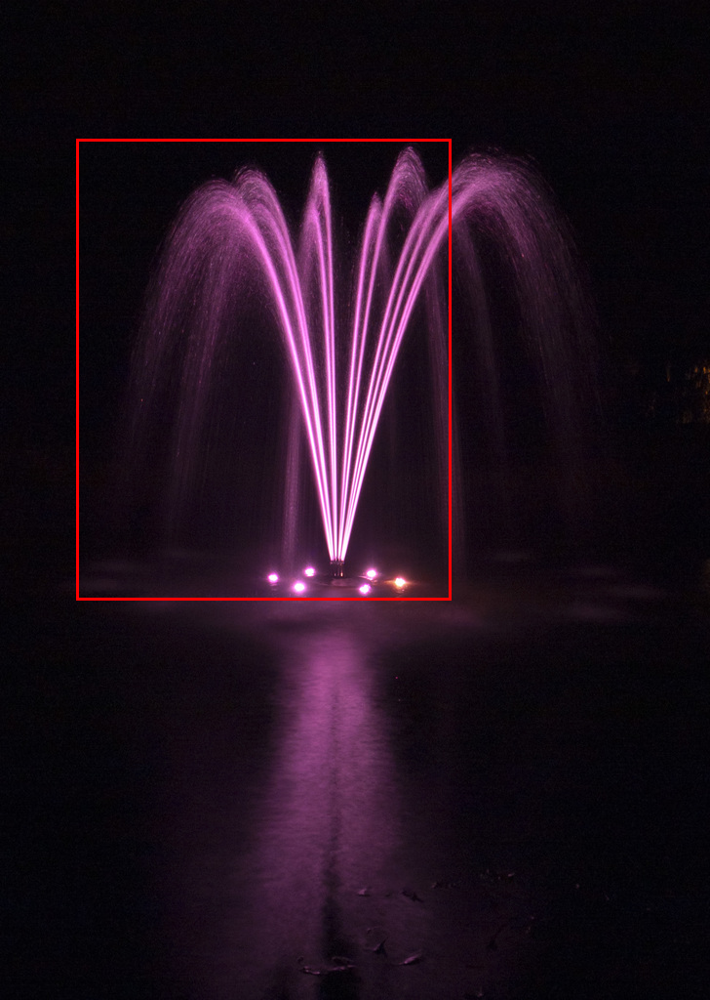

['Fountain\n']


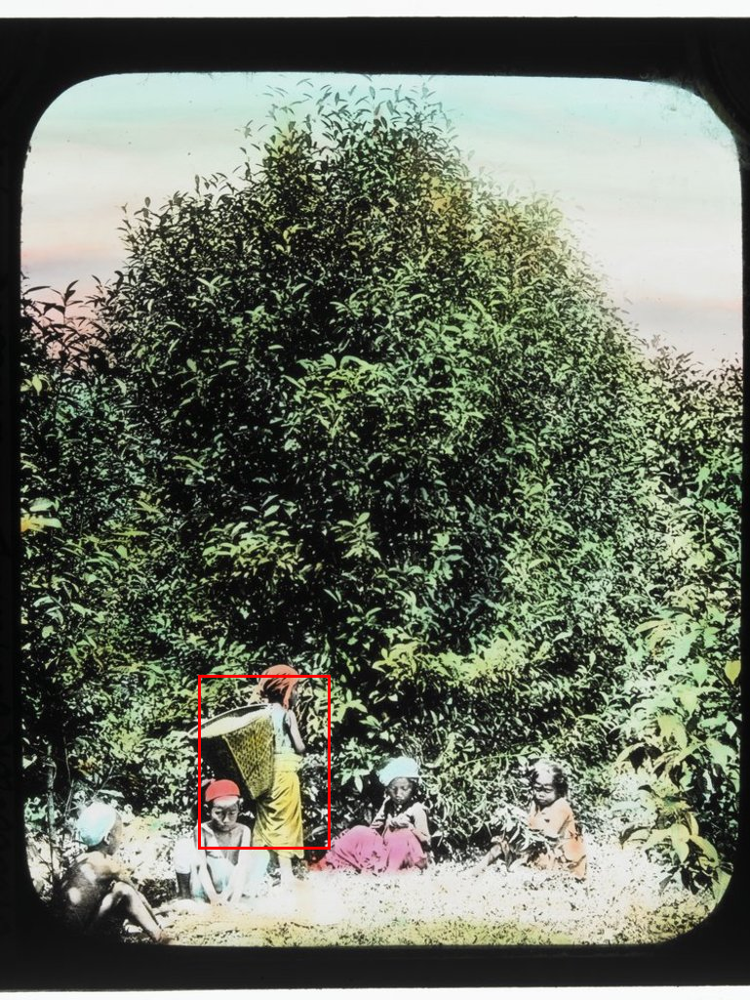

['Clothing\n']


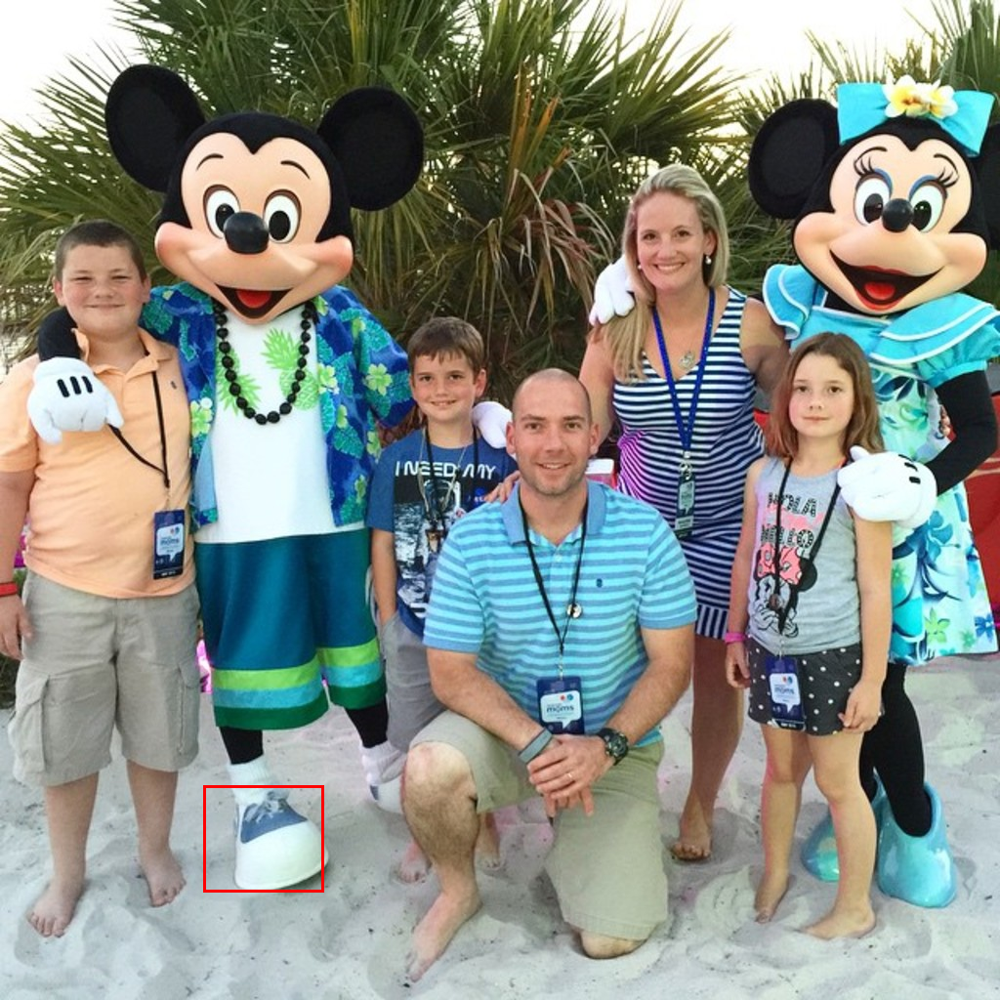

['Footwear\n']


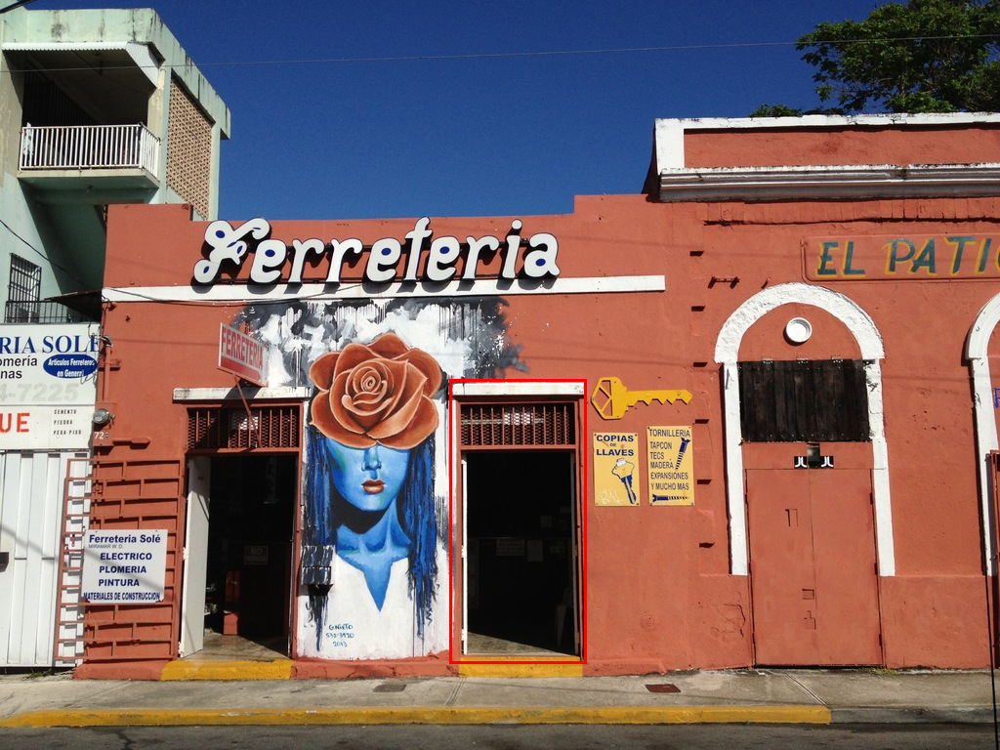

['Door\n']


In [95]:
def draw_bboxes(image, bboxes):
        draw = ImageDraw.Draw(image)
        for bbox in bboxes:
            draw.rectangle(bbox, outline='red', width=3)
        return image
        
def get_name(boxable_name, specific_name):
    # specific_nameが単一の文字列の場合、リストに変換する
    if isinstance(specific_name, str):
        specific_name = [specific_name]
        return specific_name

    # specific_nameがリストの場合の処理
    return_specific_name = np.array([])
    for col in boxable_name:
        _class, name = col.split(',')
        if _class in specific_name:
            # print(name)
            return_specific_name = np.append(return_specific_name, name)
    return return_specific_name

for i in range(20,40,1):    
    # ImageIDのユニークな値を取得
    unique_image_id = filtered_train_annotations_bbox["ImageID"].unique()
    #特定のImageIDのデータを抽出
    target_image_id = unique_image_id[i]
    filtered_data_by_imageid = filtered_train_annotations_bbox[filtered_train_annotations_bbox["ImageID"] == target_image_id]
    filtered_data_by_imageid

    img = Image.open(f'/home/dataset/openimage/train/{target_image_id}.jpg')

    bboxes = filtered_data_by_imageid.apply(lambda row: (row['XMin'] * img.width, row['YMin'] * img.height, 
                                row['XMax'] * img.width, row['YMax'] * img.height), axis=1).tolist()
    drawn_image = draw_bboxes(img, bboxes)
    img.show()
    # img.save(f'/home/oshita/vlm/mirage-defect/image/{target_image_id}.jpg')
    print(get_name(boxable_name,filtered_data_by_imageid['LabelName'].tolist()))